在空间转录组数据分析方面，[`squidpy`](https://squidpy.readthedocs.io/en/stable/tutorials.html#%3E)显然更胜一筹，`scanpy`中的流程可以看作是`squidpy`的简化版本。

这里我们主要通过`10X Genomics Visium`数据来演示空转分析流程，并且提供了一个`MERFISH`的案例。<br>

本教程的分析都在`Python`环境中完成，没有`Python`基础的同学可以参考我们之前整理的教程：[生信Python速查手册](https://mp.weixin.qq.com/s?__biz=MzAwMzIzOTk5OQ==&mid=2247499921&idx=1&sn=dcd6f95596e3de9bf378d850c217fe78&chksm=9b3cb9c1ac4b30d7bbd44057b181f87541f5904d24f903494ae557e768ae00c208c1b68b45c7&payreadticket=HJwg1QnPoRz6efK8s8uTG58KPnUTxGzPqrUmPKqY8mSwVFBC5uzFiQiC41xx3fbtfcKPXo4#rd)

# 一、空间转录组基础分析流程
## 1.1 环境配置

In [ ]:
# 加载os
import os 

# 查看当前路径
os.getcwd()

In [ ]:
# 更改当前路径
os.chdir('e:/本地生信教程/数据分析与可视化（谁删了自己去死）/空间转录组分析/scanpy_st')

# 查看当前路径
os.getcwd()

In [ ]:
# 加载需要的模块
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

#全局设置：

sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8), dpi = 300)
sc.settings.verbosity = 3

## 1.2 读取数据
这是一个来自10X Genomics的人类淋巴结空转数据，大家可以顺着链接填写邮箱去下载：[点击跳转](https://support.10xgenomics.com/spatial-gene-expression/datasets/1.0.0/V1_Human_Lymph_Node)<br>


In [ ]:
# 或者试试这样下载：
! mkdir  V1_Human_Lymph_Node
! cd  V1_Human_Lymph_Node
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_image.tif
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_molecule_info.h5
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_filtered_feature_bc_matrix.h5
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_filtered_feature_bc_matrix.tar.gz
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_raw_feature_bc_matrix.h5
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_raw_feature_bc_matrix.tar.gz
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_analysis.tar.gz
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_spatial.tar.gz
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_metrics_summary.csv
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_web_summary.html
! wget https://cf.10xgenomics.com/samples/spatial-exp/1.0.0/V1_Human_Lymph_Node/V1_Human_Lymph_Node_cloupe.cloupe

上述是`Space Ranger`(可以理解为`cellranger`的空转版，负责将原始的测序数据转换为下游`R`或`Python`可分析的数据)的输出结果，包含在`outs/`文件夹中，其对应含义分别为：<br>
- **web_summary.html**
网页总结报告，主要包括一些质控的数据<br>

- metrics_summary.csv
质量评估的具体指标结果<br>

- **cloupe.cloupe**
用于`Loupe Browser`分析的输入文件<br>

- **analysis/与spatial/spatial_enrichment.csv**
次级分析文件，例如聚类结果与DEG结果<br>

- **spatial/**
收录了图像处理的结果，包含输入图像、质控、`barcode`坐标信息等<br>

- **molecule_info.h5**
收录了`spaceranger aggr`与`spaceranger targeted-compare`这类附加`pipeline`的分子水平信息<br>

- **Barcoded BAM**
收录`reads`的比对情况<br>

- **Filtered GEX Matrix**
有两种格式的拷贝——`filtered_feature_bc_matrix/`与`HD5F: filtered_feature_bc_matrix.h5`，包含了过滤后的`barcodes`、`features`、`matrices`信息，可用于下游`R`/`Python`的输入。<br>

- **Unfiltered GEX Matrix**
与`Filtered GEX Matrix`类似，但没有经过过滤，即包含背景信息。<br>

scanpy中也提供了函数可以直接下载数据并返回`adata`对象:<br>

In [ ]:
# 自动下载数据并返回`adata`对象:
# 数据已存在时会跳过下载过程直接读取
adata = sc.datasets.visium_sge(sample_id="V1_Human_Lymph_Node")

type(adata)

In [ ]:
# 或者用sc.read_visium函数也可直接读取数据
adata = sc.read_visium('./data/V1_Human_Lymph_Node/')
type(adata)

`./data/V1_Human_Lymph_Node/`目录中的数据结构为：<br>
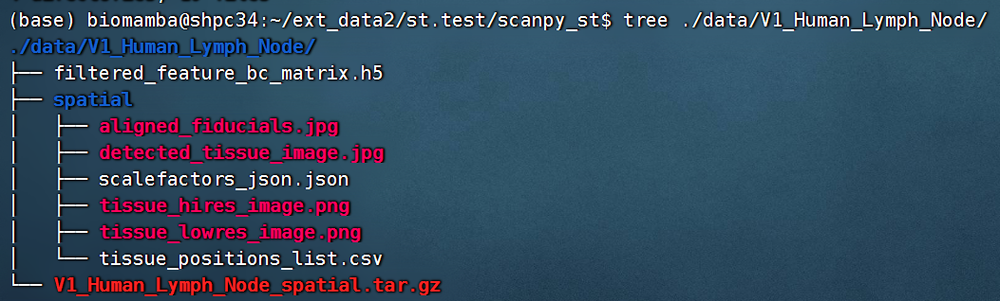

In [5]:
# 保证每个var的变量名唯一：
adata.var_names_make_unique()

# 以MT开头的基因构建mt
adata.var["mt"] = adata.var_names.str.startswith("MT-")

# 核糖体基因
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))

# 血红蛋白基因
adata.var["hb"] = adata.var_names.str.contains(("HB[(P)]"))

# 计算以上三者含量
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt', 'ribo', 'hb'], inplace=True)

In [ ]:
adata

## 1.3 质控与预处理
基础的过滤与`scRNA-Seq`部分大同小异<br>
### 1.3.1 质控与过滤

In [ ]:
#设置画布大小：
fig, axs = plt.subplots(1, 5, figsize=(15, 4))

# 绘制`total_counts`分布柱状图：
sns.displot(adata.obs["total_counts"], kde=False, ax=axs[0])

# 过滤保留`total_counts`小于10000的spot：
sns.displot(adata.obs["total_counts"][adata.obs["total_counts"] < 10000], kde=False, bins=40, ax=axs[1])

# 查看以bins=60划分空间单元后n_genes_by_counts的分布情况：
sns.displot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])

# 如果需要Kernel密度分布曲线，可选择kde=True：
sns.displot(adata.obs["n_genes_by_counts"], kde=True, bins=60, ax=axs[3])

# 过滤保留n_genes_by_counts小于4000的spot
sns.displot(adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[4])

### 1.3.2 过滤及预处理
主要是依靠`counts`、线粒体含量、基因表达情况进行过滤，该部分与`scRNA-Seq`几乎一样：<br>

In [ ]:
# 过滤保留counts在5000~35000之间的细胞：
sc.pp.filter_cells(adata, min_counts=5000)
sc.pp.filter_cells(adata, max_counts=35000)

# 过滤保留线粒体含量低于20%的细胞：
adata = adata[adata.obs["pct_counts_mt"] < 20]

# 查看线粒体过滤后保留的细胞数：
print(f"线粒体过滤后的细胞数量为: {adata.n_obs}\n----------")

# 过滤保留表达细胞数大于等于10个的基因：
sc.pp.filter_genes(adata, min_cells=10)

`nomalization`的方法有[`SCTransform`](https://genomebiology.biomedcentral.com/articles/10.1186/s13059-019-1874-1)、[`GLM-PCA`](https://genomebiology.biomedcentral.com/articles/10.1186/s13059-019-1861-6)，更多方法可见[参考文献](https://www.embopress.org/doi/full/10.15252/msb.20188746)。这里作者用`Scanpy`内置的算法做演示：<br>

In [ ]:
# inplace=True可以直接将normalization矩阵传回adata.X` 和`adata.layers中
sc.pp.normalize_total(adata, inplace=True)

# 相当于做了ln(x+1)的操作
sc.pp.log1p(adata)

# 寻找top2000的高变基因，与scRNA-Seq部分一致
sc.pp.highly_variable_genes(adata,  
                            n_top_genes = 2000)

## 1.4 降维可视化
同样与`scRNA-Seq`部分一致：<br>

In [ ]:
# 利用上述计算得到的高变基因进行PCA分析
sc.pp.pca(adata)

# 计算neighbors
sc.pp.neighbors(adata, n_pcs = 50)

# umap降维分析
sc.tl.umap(adata)

# leiden分群并将结果存在clusters变量中
sc.tl.leiden(adata, key_added="clusters", resolution = 0.5)

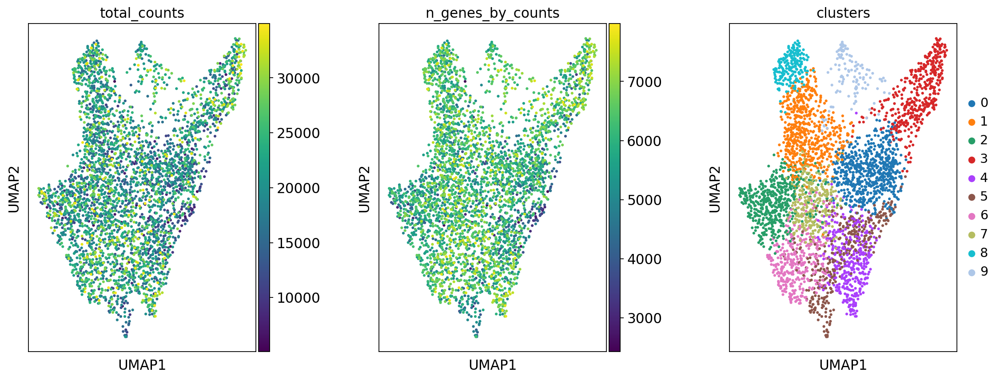

In [11]:
# 设置画布
plt.rcParams["figure.figsize"] = (4, 6)

# 查看"total_counts", "n_genes_by_counts", "clusters"在umap中的分布情况
sc.pl.umap(adata, color=["total_counts", "n_genes_by_counts", "clusters"], 
           wspace=0.4)

## 1.5 结合空间信息进行可视化
这一点是`scRNA-Seq`无法比拟的，上面的`umap`可视化展示的是利用数据特征降维的结果，而空转数据可以通过`scspatial`函数结合空间坐标信息与影像图片(例如HE染色图像)进行可视化。<br>

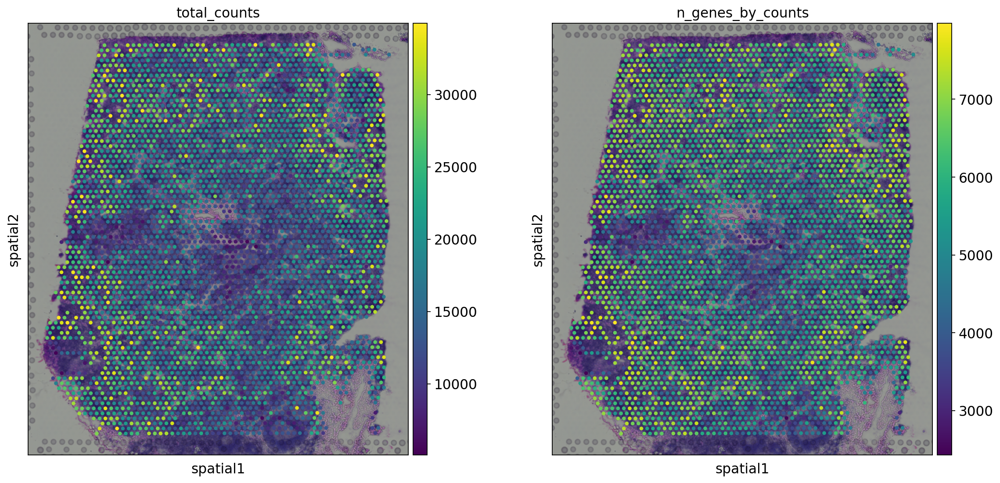

In [12]:
# 设置画布：
plt.rcParams["figure.figsize"] = (8, 8)

# 展示"total_counts", "n_genes_by_counts"结合image的分布情况：
sc.pl.spatial(adata, img_key = "hires", # img_key存放于adata.uns
              color = ["total_counts", "n_genes_by_counts"])
# sc.pl.spatial运行的时间要远高于sc.pl.umap

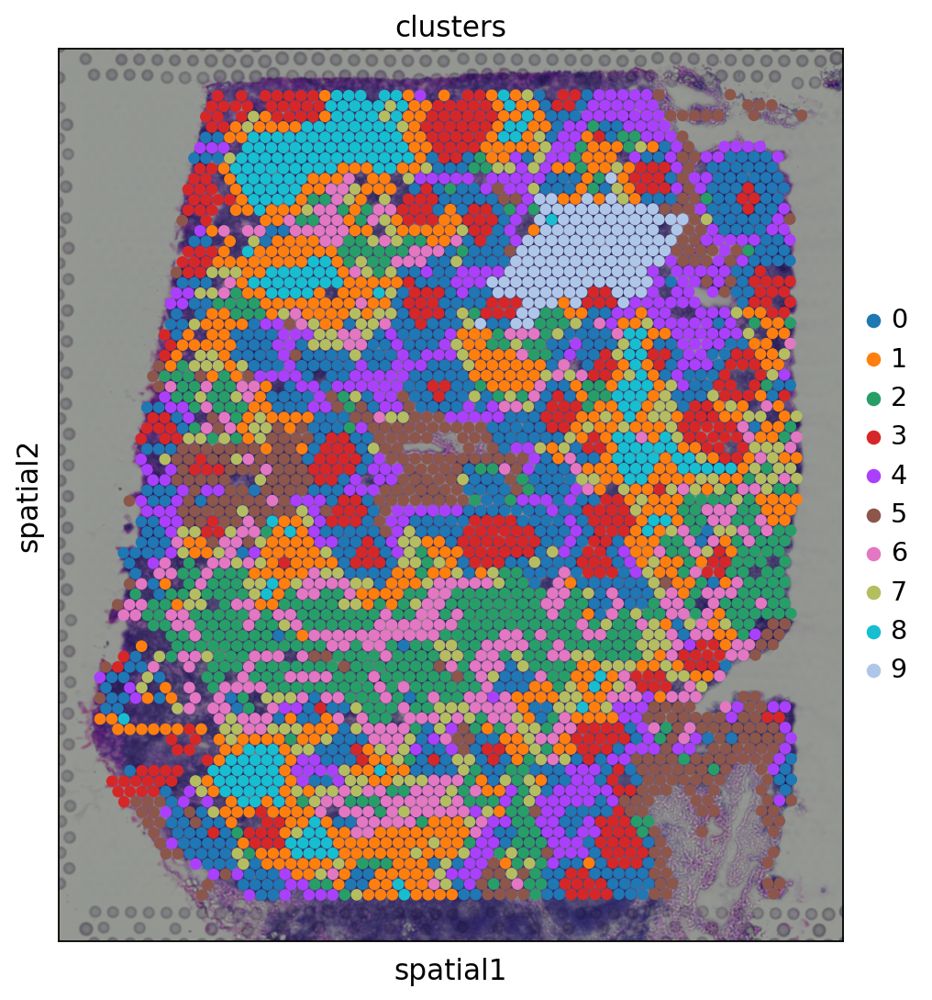

In [13]:
# spot的大小可以通过size调整：
sc.pl.spatial(adata, img_key = "hires", color = "clusters", 
              size = 1.5)
# size=1.5稍显过大，刚好把组织全覆盖住

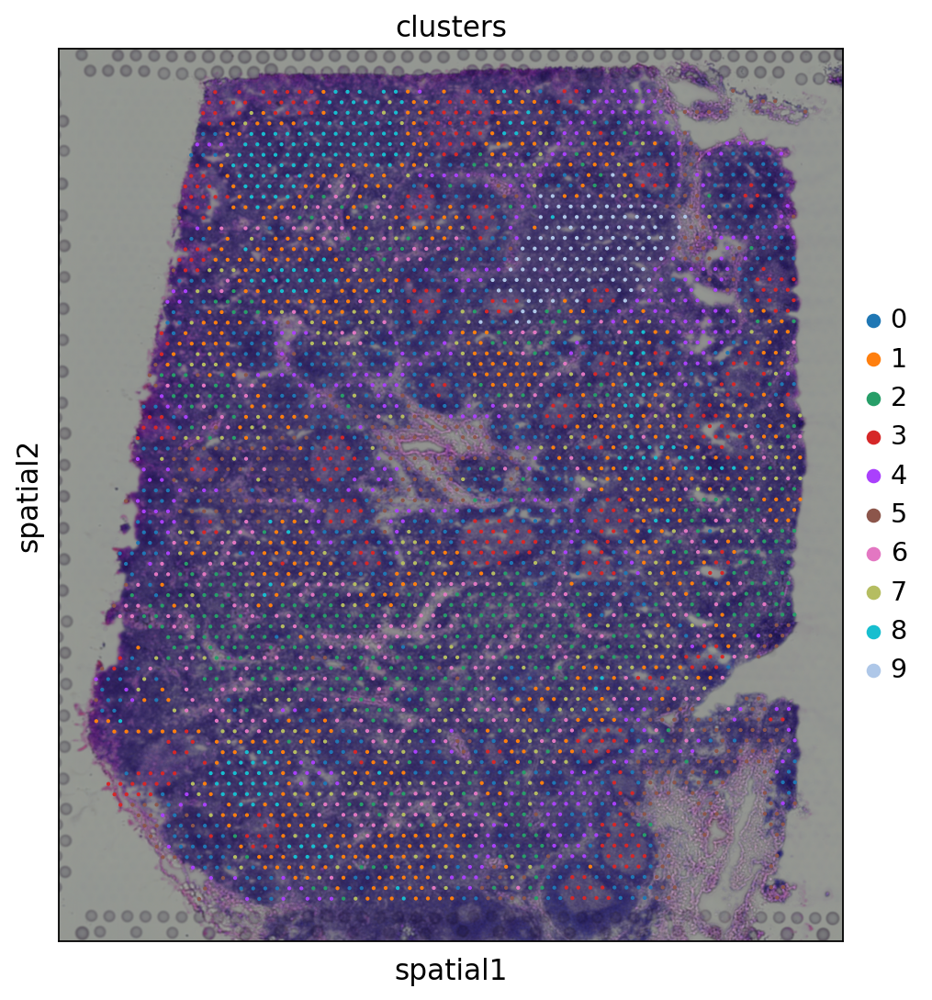

In [14]:
sc.pl.spatial(adata, img_key = "hires", color = "clusters", 
              size = 0.5)
# size=0.5显然就过小了

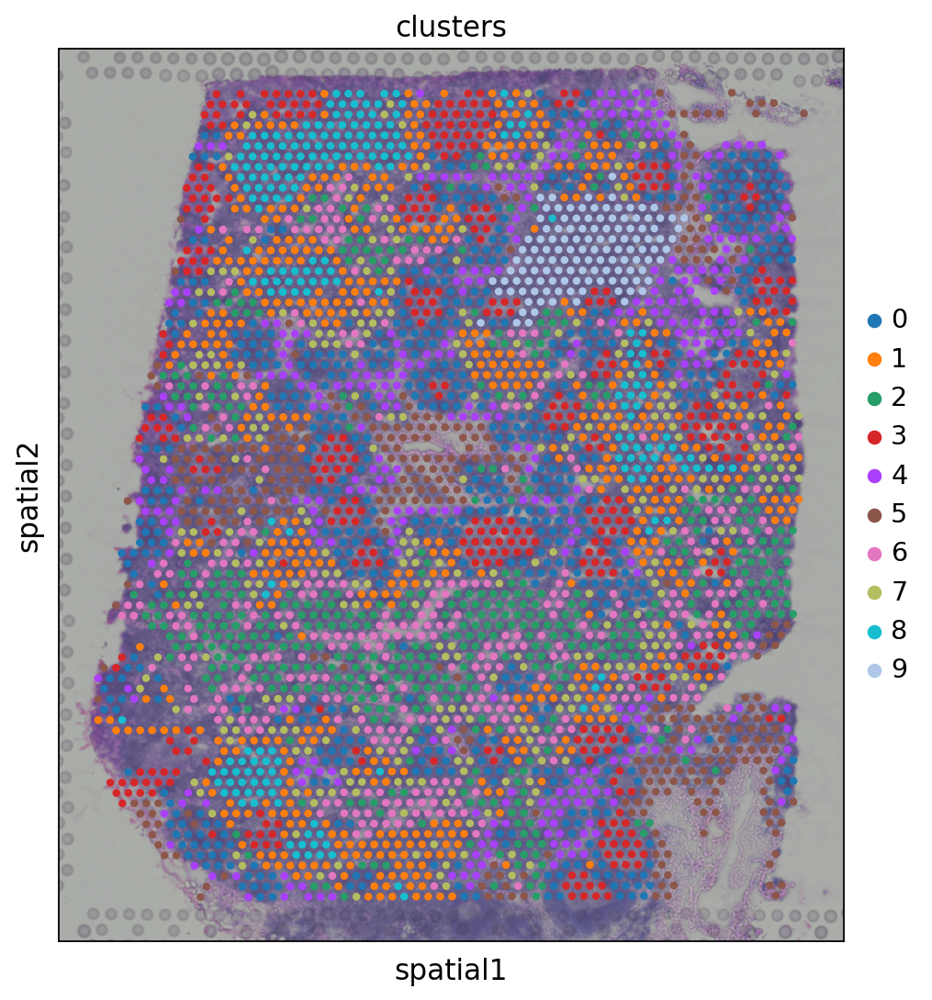

In [16]:
# alpha_img可以调整HE染色结果的透明度：
sc.pl.spatial(adata, img_key="hires", color="clusters", size=1
             ,alpha_img = 0.8)

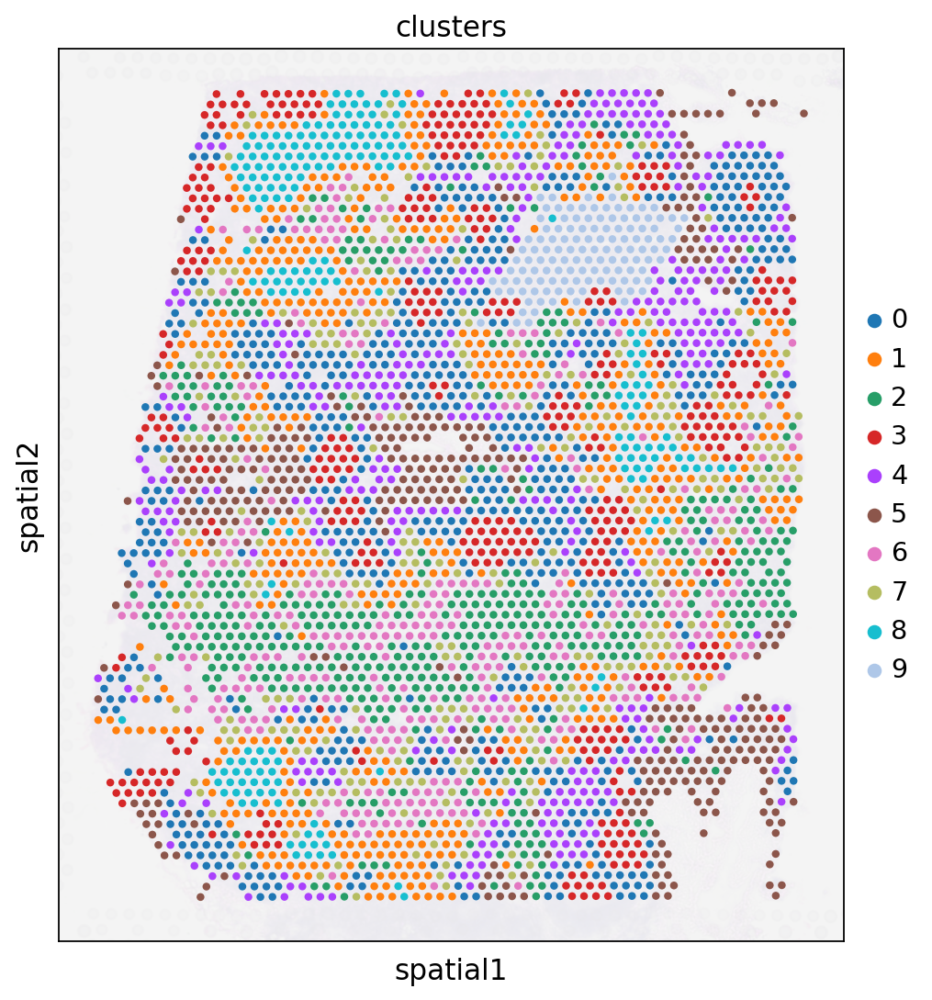

In [17]:
sc.pl.spatial(adata, img_key="hires", color="clusters", size=1
             ,alpha_img = 0.1)
# alpha_img=0.1，HE图像几乎透明

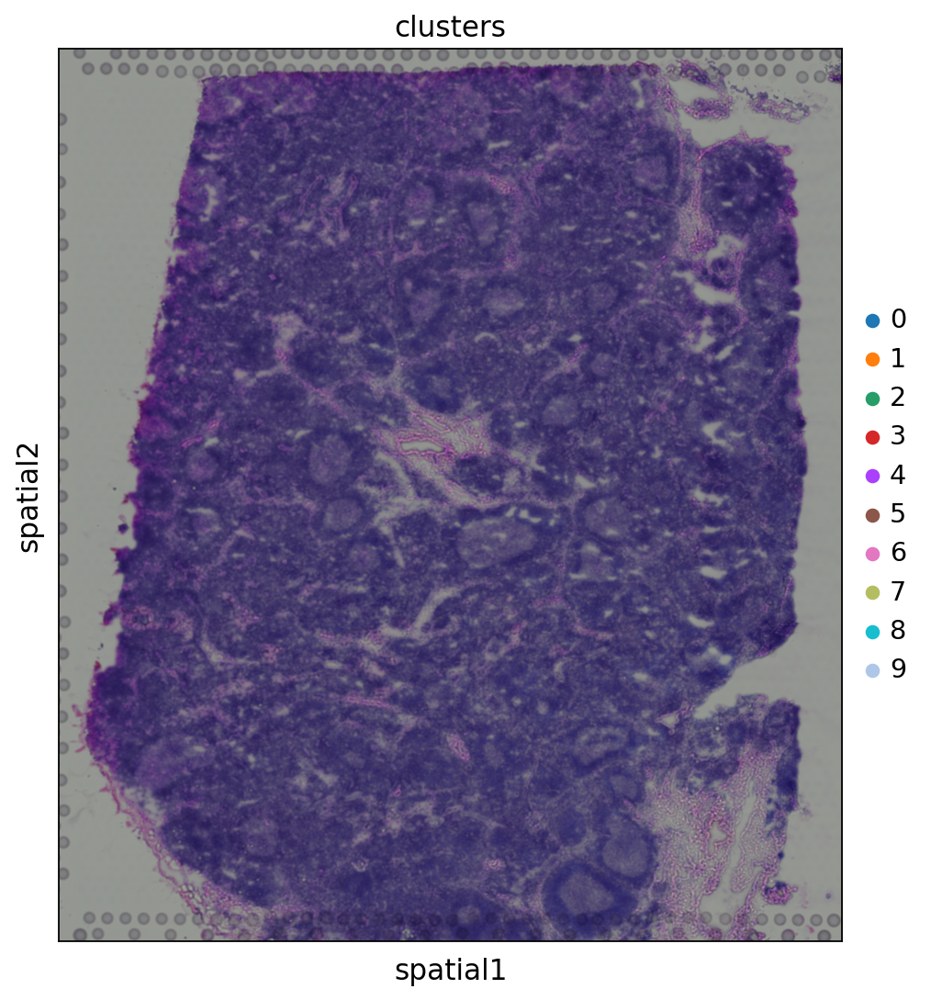

In [22]:
# bw参数可以控制是否对影像图片进行灰度处理，默认为False
sc.pl.spatial(adata, img_key="hires", color="clusters",size = 0,
             bw = False)
# 这里我们将size=0，让背景影像最大程度展现：

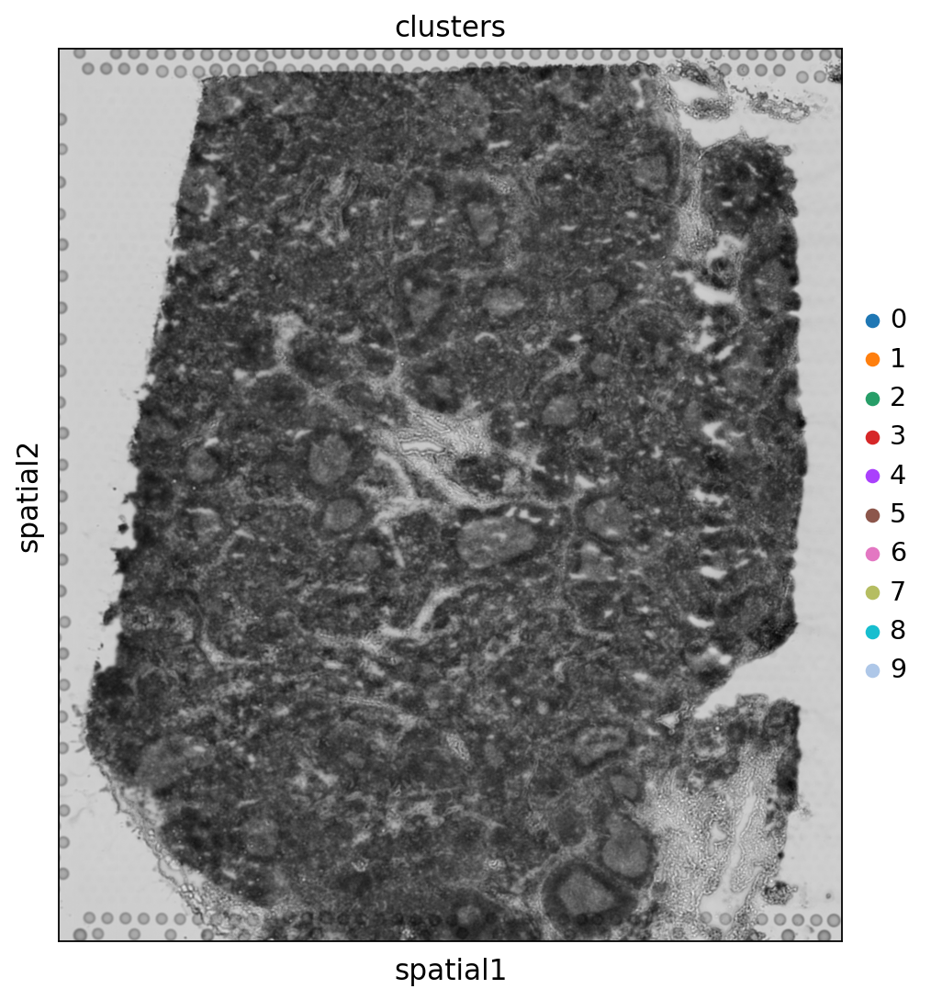

In [23]:
# bw = True时，可明显看出，HE染色背景变为灰度
sc.pl.spatial(adata, img_key = "hires", color = "clusters", size = 0,
             bw = True)

## 1.6 marker基因计算
这部分内容依旧与`scRNA-Seq`部分无异

In [ ]:
# 计算每个clusters的marker gene
sc.tl.rank_genes_groups(adata, "clusters",
                        method = "t-test") # method可以在['logreg', 't-test', 'wilcoxon', 't-test_overestim_var']中选择

# 用热图展示cluster5的top10marker
sc.pl.rank_genes_groups_heatmap(adata, groups = "5", n_genes = 10, groupby = "clusters")

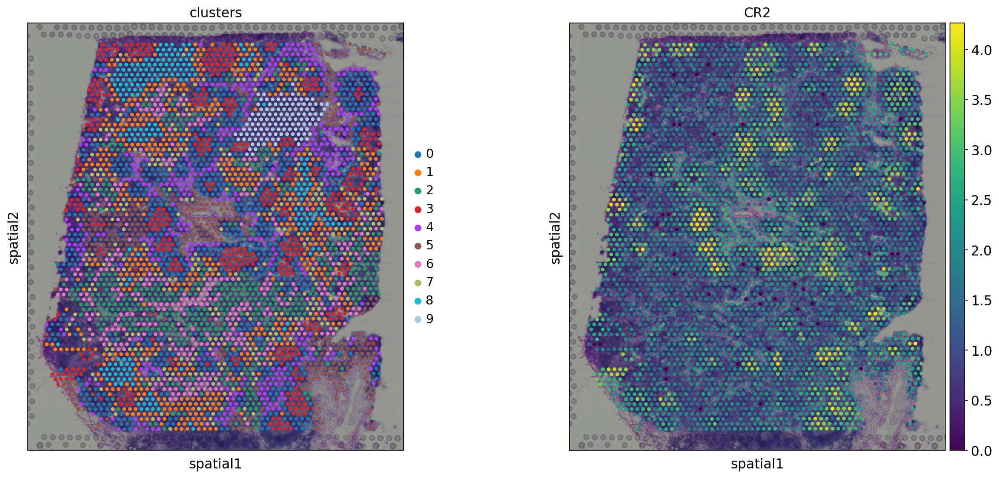

In [27]:
# 查看CR2在各cluster间的表达情况：
sc.pl.spatial(adata, img_key = "hires", 
              color = ["clusters", "CR2"])

## 1.7 空间特异性基因
这部分同样是空转独有的分析，通过[`spatialde`](https://www.nature.com/articles/nmeth.4636)包，可以充分探索存在空间分布变化的基因。除了`spatialde`外，[SPARK](https://github.com/xzhoulab/SPARK)、[trendsceek](https://github.com/edsgard/trendsceek)、[HMRF](https://bitbucket.org/qzhudfci/smfishhmrf-py/src/default/)也可完成类似计算。  

In [ ]:
# 安装spatialde：
! pip install spatialde

In [33]:
# 第一次运行SpatialDE时我的jupyter Notebook直接挂了，先保存一下镜像：
import dill 
filename = 'temp.pkl'
dill.dump_session(filename)

In [34]:
# 导包：
import SpatialDE

In [36]:
# 将count与坐标信息coord都转变为pandas数据框格式
counts = pd.DataFrame(adata.X.todense(), 
                      columns = adata.var_names, 
                      index = adata.obs_names)
coord = pd.DataFrame(adata.obsm['spatial'], 
                     columns = ['x_coord', 'y_coord'], 
                     index = adata.obs_names)

In [ ]:
%%time
results = SpatialDE.run(coord, counts) # 即使测试样本量很小，实际计算也花费了超过一小时

In [ ]:
# 得到的结果是一个pands的DataFrame
print(f"results的数据类型为:\n{type(results)}\n-----------")
results.headd()

In [42]:
# 按照qval查看最显著的10个基因：
results.sort_values("qval").head(10)

,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC,max_ll_null,LLR,pval,qval
6580,0.252637,4,EZR,248.797504,2.942471,-2352.853198,1.963781,0.221246,SE,3861,0.000004,0.000114,0.018788,4738.741122,-2634.194635,281.341436,0.0,0.0
6801,0.252614,4,CD3D,248.797504,2.942819,-3058.270450,1.545435,0.184061,SE,3861,0.000004,0.000108,0.045519,6149.575626,-3390.038078,331.767628,0.0,0.0
6800,0.275111,4,CD3E,248.797504,2.620830,-3128.430222,1.438254,0.184299,SE,3861,0.000004,0.000096,0.031763,6289.895169,-3493.500944,365.070722,0.0,0.0
6799,0.266293,4,POU2AF1,248.797504,2.740558,-2634.446969,1.853895,0.218209,SE,3861,0.000004,0.000122,0.033414,5301.928664,-2920.768755,286.321786,0.0,0.0
8439,0.094810,4,RAN,474.158722,9.364228,-2299.115058,1.954837,0.068055,SE,3861,0.000010,0.001219,0.012807,4631.264843,-2399.933886,100.818828,0.0,0.0
13921,0.233113,4,FLNC,1722.182579,2.640896,1572.104256,0.057914,0.009598,SE,3861,0.000687,0.022195,0.066519,-3111.173786,1490.421257,81.682999,0.0,0.0
6791,0.311412,4,RPS3,248.797504,2.199383,840.487222,3.730707,0.628315,SE,3861,0.000003,0.000076,0.034838,-1647.939719,350.664220,489.823002,0.0,0.0
8450,0.334106,4,RPL21,474.158722,1.954834,1121.026939,3.982233,0.246899,SE,3861,0.000016,0.000357,0.031010,-2209.019152,502.302089,618.724850,0.0,0.0
6787,0.174956,4,ACY3,248.797504,4.690548,-884.556911,0.145126,0.018326,SE,3861,0.000006,0.000283,0.044296,1802.148548,-1002.687235,118.130324,0.0,0.0
8983,0.080953,4,RANBP1,474.158722,11.135019,-3125.155899,1.260087,0.045002,SE,3861,0.000010,0.001581,0.113367,6283.346524,-3203.434424,78.278525,0.0,0.0


In [43]:
# 把计算结果添加到`AnnData`的注释变量中：
results.index = results["g"]
adata.var = pd.concat([adata.var, results.loc[adata.var.index.values, :]], axis=1)

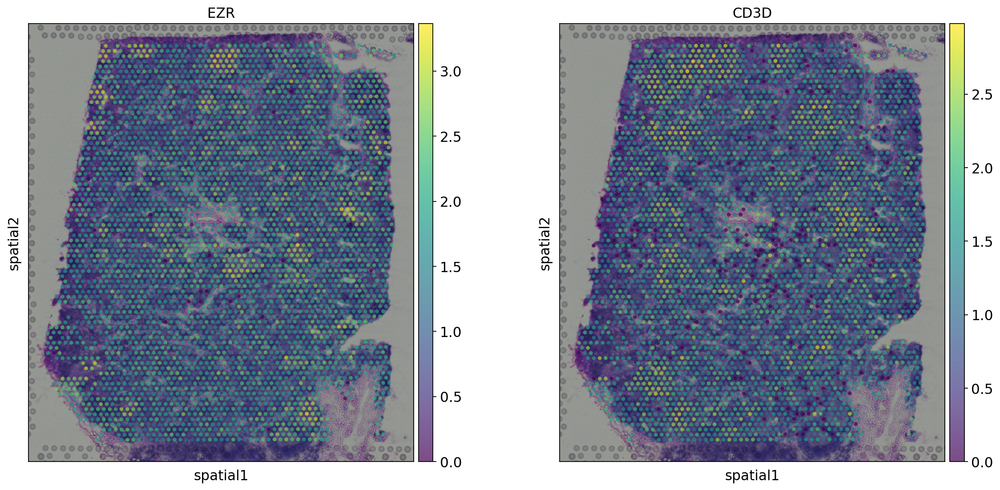

In [44]:
# 浅画两个看一下结果：
sc.pl.spatial(adata, img_key="hires", 
              color=["EZR", "CD3D"], alpha=0.7)    

## 1.8 MERFISH数据示例
空转目前主流策略分为`NGS-based`技术(例如10X visium与stereo-Seq)与`Image-based`(例如MERFISH)两种。上面我们介绍了10X visum的流程，下面我们介绍MERFISH的流程，后续单独介绍stereo-seq的流程。

`Scanpy`显然两类数据均可以支持。这里的测试数据来自于一篇`PNAS`的文章：[点击跳转](https://www.pnas.org/doi/10.1073/pnas.1912459116)。

### 1.8.1 数据下载与读入

In [ ]:
# 导包：
import urllib.request

# 空间坐标文件地址：
url_coord = "https://www.pnas.org/highwire/filestream/887973/field_highwire_adjunct_files/15/pnas.1912459116.sd15.xlsx"
# 空间坐标文件本地文件名：
filename_coord = "pnas.1912459116.sd15.xlsx"
# 文件下载至本地：
urllib.request.urlretrieve(url_coord, filename_coord)

# counts文件地址
url_counts = "https://www.pnas.org/highwire/filestream/887973/field_highwire_adjunct_files/12/pnas.1912459116.sd12.csv"
# counts文件本地文件名
filename_counts = "pnas.1912459116.sd12.csv"

# 文件下载至本地：
urllib.request.urlretrieve(url_counts, filename_counts)

# 此处下载可能被墙，因此我直接在文章页面下载至本地

In [ ]:
# 安装依赖包
! pip install openpyxl

In [54]:
coordinates = pd.read_excel("./data/merfish/pnas.1912459116.sd15.xlsx", index_col=0)
# 读入的是pandas的数据框，可以看一下内容：
coordinates.iloc[0:5,0:3]

,x_microns,y_microns
B1_cell1,-891.313702,-1464.550024
B1_cell2,-609.526668,-1457.751892
B1_cell3,-416.254156,-1451.438190
B1_cell4,-283.819862,-1470.768830
B1_cell5,-83.990122,-1472.083057


In [ ]:
# 读入count并直接构建`AnnData`对象
counts = sc.read_csv("./data/merfish/pnas.1912459116.sd12.csv").transpose()

# counts直接就是个AnnData对象：
type(counts)

In [57]:
# 整合空间信息与counts：
adata_merfish = counts[coordinates.index, :]
adata_merfish.obsm["spatial"] = coordinates.to_numpy()
adata_merfish # 得到完整的AnnData对象，共包含645个spots与12903个基因

AnnData object with n_obs × n_vars = 645 × 12903
    obsm: 'spatial'

### 1.8.2 数据预处理
预处理方面与上述`10X Visium`的路程基本无差别。<br>

In [ ]:
# normalize
sc.pp.normalize_per_cell(adata_merfish, counts_per_cell_after=1e6)

# ln(X+1)
sc.pp.log1p(adata_merfish)

# PCA
sc.pp.pca(adata_merfish, n_comps=15)

# 降维
sc.pp.neighbors(adata_merfish)
sc.tl.umap(adata_merfish)

# 分群
sc.tl.leiden(adata_merfish, key_added="clusters", 
             resolution=0.5)# 可以根据分群的特征调整resolution

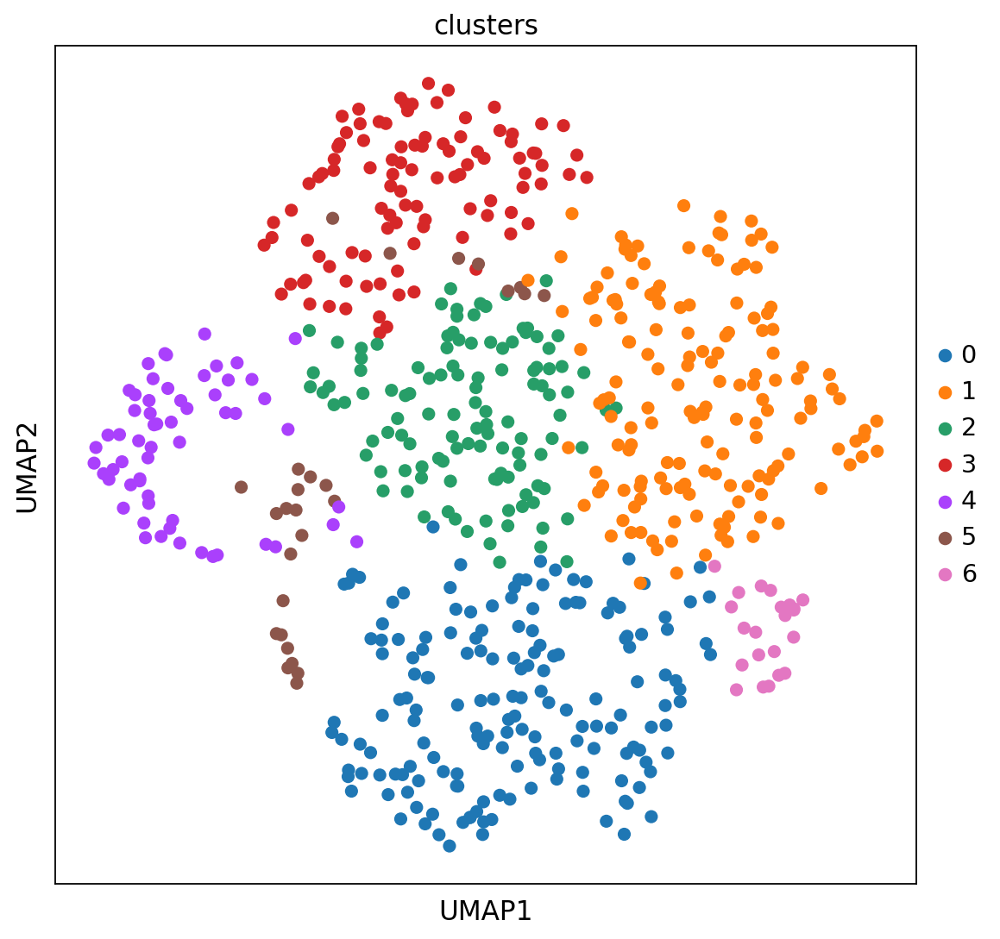

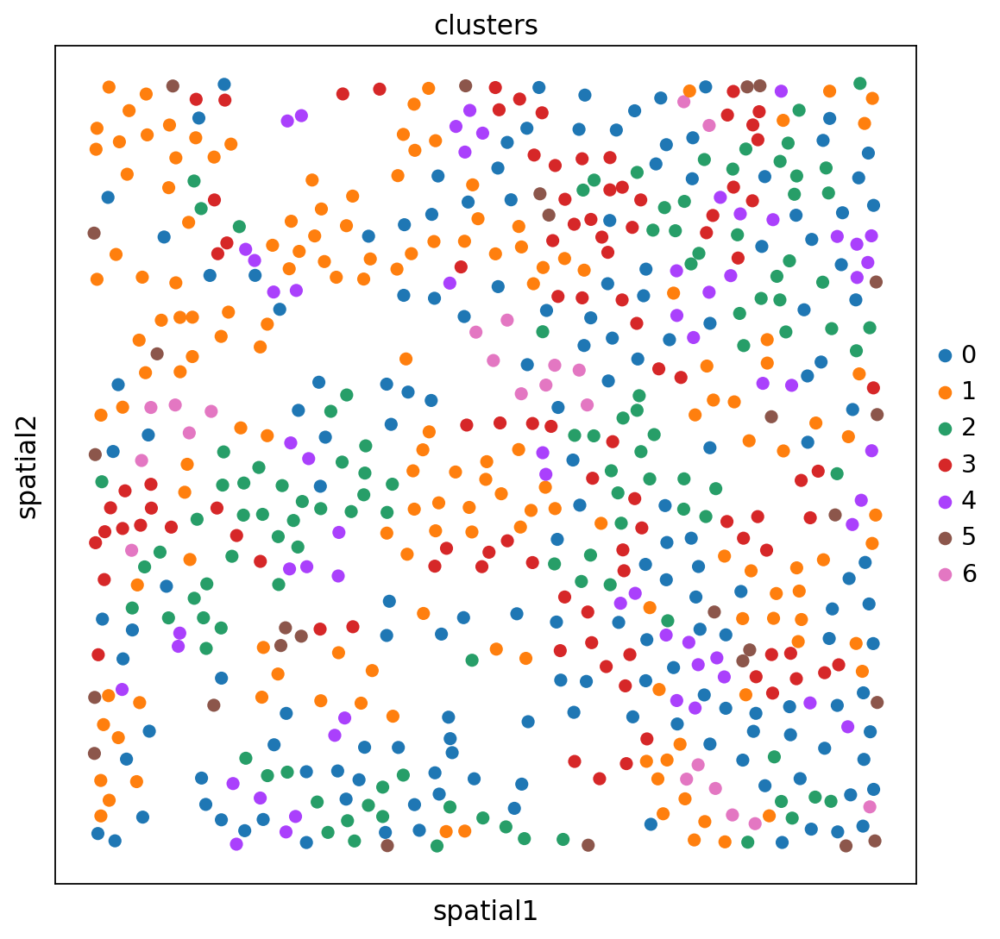

In [60]:
# 降维的可视化也同样可以使用：
sc.pl.umap(adata_merfish, color="clusters")
sc.pl.embedding(adata_merfish, basis="spatial", color="clusters")

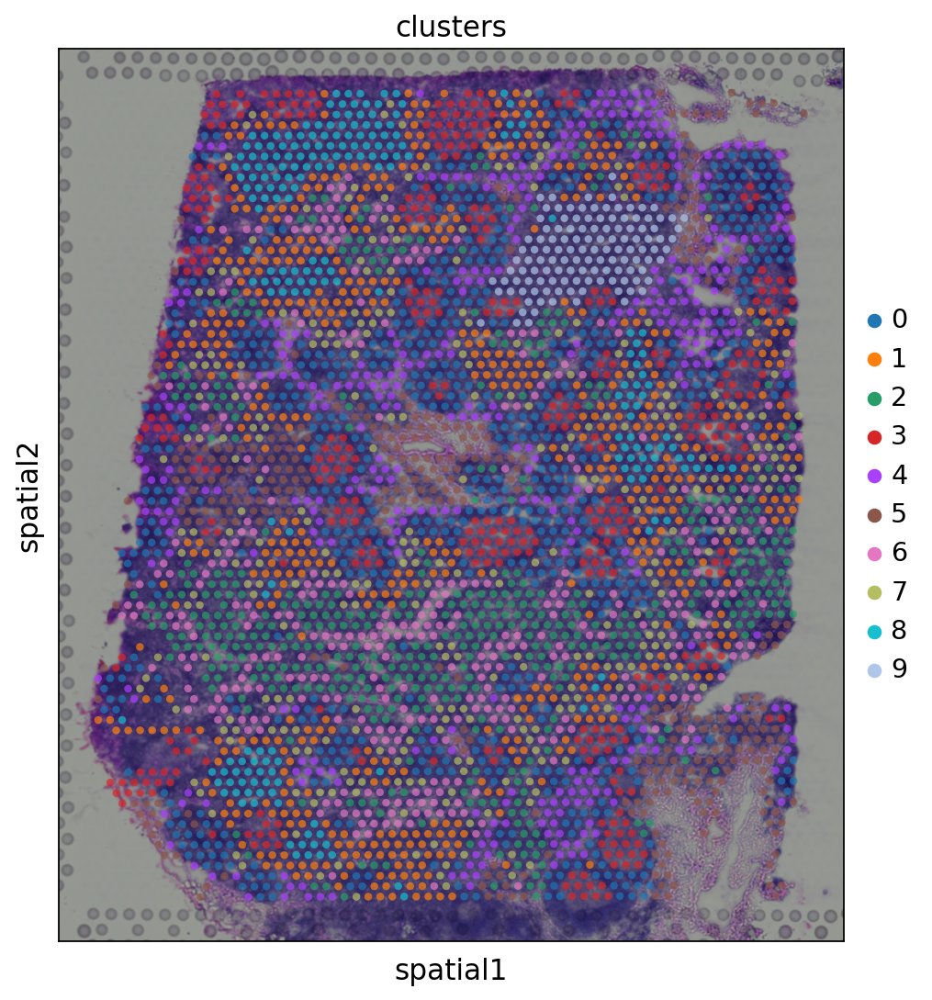

In [59]:
# 来看看MERFISH的spatial可视化，肉眼上很难看出与10X visium数据的差别：
sc.pl.spatial(adata, img_key = "hires", 
              color = ["clusters"], alpha = 0.7) 

# 二、空转多样本数据整合
这部分内容同样是基于`SquidPy`，流程可参考[`Scanorama`](https://www.nature.com/articles/s41587-019-0113-3)。
## 2.1 准备工作

In [ ]:
# 安装依赖包：
# scanpy与anndata可以从github里pull最新版的
!pip install git+https://github.com/theislab/scanpy.git
!pip install git+https://github.com/theislab/anndata.git
!pip install scanorama

In [62]:
# 导包
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scanorama

In [ ]:
# 设置一些全局参数：
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 3

## 2.2 数据读取
这里用到的空转数据来自小鼠的大脑，可以在`10X genomics`的网页上下载([点击跳转](https://support.10xgenomics.com/spatial-gene-expression/datasets/))，也可以用`scanpy`内置的`datasets.visium_sge()`函数去直接下载并创建`AnnData`对象。<br>

In [ ]:
# 在我的服务器上读取速度很快，几秒钟即可搞定
adata_spatial_anterior = sc.datasets.visium_sge(
    sample_id="V1_Mouse_Brain_Sagittal_Anterior"
)
adata_spatial_posterior = sc.datasets.visium_sge(
    sample_id="V1_Mouse_Brain_Sagittal_Posterior"
)

## 2.3 预处理
参考我们上一节的内容，预处理基本没差别，分别对两个样本的数据进行初步计算：<br>

In [ ]:
# 构建对象并完成初步质控
adata_spatial_anterior.var_names_make_unique()
adata_spatial_posterior.var_names_make_unique()
sc.pp.calculate_qc_metrics(adata_spatial_anterior, inplace=True)
sc.pp.calculate_qc_metrics(adata_spatial_posterior, inplace=True)

for name, adata in [
    ("anterior", adata_spatial_anterior),
    ("posterior", adata_spatial_posterior),
]:
    fig, axs = plt.subplots(1, 4, figsize=(12, 3))
    fig.suptitle(f"Covariates for filtering: {name}")

    sns.displot(adata.obs["total_counts"], kde=False, ax=axs[0])
    sns.displot(
        adata.obs["total_counts"][adata.obs["total_counts"] < 20000],
        kde=False,
        bins=40,
        ax=axs[1],
    )
    sns.displot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
    sns.displot(
        adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 4000],
        kde=False,
        bins=60,
        ax=axs[3],
    )

# normalize与高变基因计算，用于下游的数据整合
for adata in [
    adata_spatial_anterior,
    adata_spatial_posterior,
]:
    sc.pp.normalize_total(adata, inplace=True)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=2000, inplace=True)

## 2.4 数据整合
利用`Scanorama`整合空转数据可以返回两个`list`，一个包含`integrated embeddings`一个包含校正后的`counts`数据

In [ ]:
# 简单合并两个数据
adatas = [adata_spatial_anterior, adata_spatial_posterior]

# 利用scanorama做批次矫正
adatas_cor = scanorama.correct_scanpy(adatas, 
                                      return_dimred=True)
# 大约需要花费2~3min

In [68]:
# 整合
adata_spatial = sc.concat(
    adatas_cor,
    label="library_id", # 样本来源存放的slot
    uns_merge="unique", #确保两个数据集各自的spatial数据不会丢失
    keys=[
        k
        for d in [
            adatas_cor[0].uns["spatial"],
            adatas_cor[1].uns["spatial"],
        ]
        for k, v in d.items()
    ],
    index_unique="-",
)
# 大约< 1min搞定

In [ ]:
# 利用整合后的数据进行降维分群
sc.pp.neighbors(adata_spatial, use_rep="X_scanorama")
sc.tl.umap(adata_spatial)
sc.tl.leiden(adata_spatial, key_added="clusters")

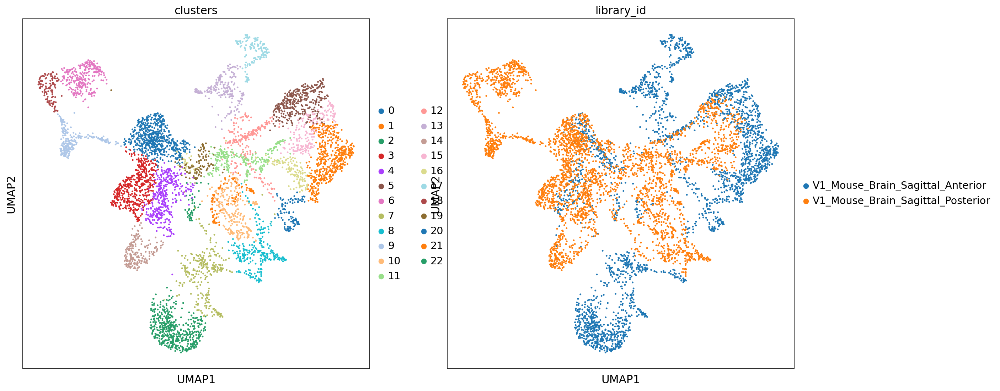

In [71]:
# 通过umap结果查看clusters与样本来源的分布情况：
sc.pl.umap(
    adata_spatial, color=["clusters", "library_id"], 
    palette=sc.pl.palettes.default_20
)

cluster与颜色的对应关系为:
{'0': '#1f77b4', '1': '#ff7f0e', '2': '#279e68', '3': '#d62728', '4': '#aa40fc', '5': '#8c564b', '6': '#e377c2', '7': '#b5bd61', '8': '#17becf', '9': '#aec7e8', '10': '#ffbb78', '11': '#98df8a', '12': '#ff9896', '13': '#c5b0d5', '14': '#c49c94', '15': '#f7b6d2', '16': '#dbdb8d', '17': '#9edae5'}


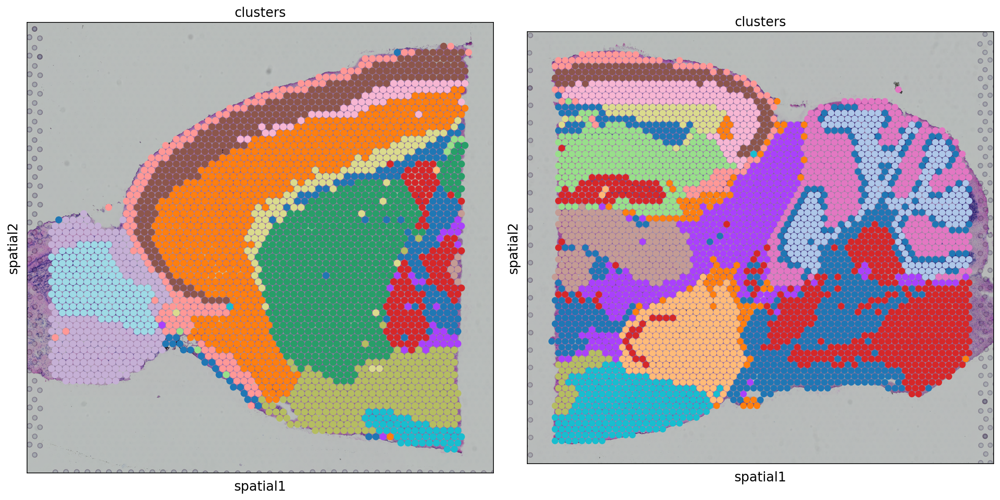

In [75]:
# 但是spatial结果就只能分开展示啦：
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

# 先为cluster分配颜色，
# 防止两个数据因为cluster分布不一致，导致同一个cluster被分配为不同颜色
clusters_colors = dict(
    zip([str(i) for i in range(18)], 
        adata_spatial.uns["clusters_colors"])
)

print(f"cluster与颜色的对应关系为:\n{clusters_colors}")

for i, library in enumerate(
    ["V1_Mouse_Brain_Sagittal_Anterior", "V1_Mouse_Brain_Sagittal_Posterior"]
):
    ad = adata_spatial[adata_spatial.obs.library_id == library, :].copy()
    sc.pl.spatial(
        ad,
        img_key="hires",
        library_id=library,
        color="clusters",
        size=1.5,
        palette=[
            v
            for k, v in clusters_colors.items()
            if k in ad.obs.clusters.unique().tolist()
        ],
        legend_loc=None,
        show=False,
        ax=axs[i],
    )

plt.tight_layout()

# 三、空转与scRNA-Seq数据整合分析
类似于做`scRNA-Seq`的`label Transfer`，空转数据也可以利用`scRNA-Seq`数据进行注释。
## 3.1 scRNA-Seq准备
### 3.1.1 文件下载
这里作者引入了一个来自于`smart-seq`的数据([点击跳转](https://www.nature.com/articles/s41586-018-0654-5))。`count`([点击跳转](https://ftp.ncbi.nlm.nih.gov/geo/series/GSE115nnn/GSE115746/suppl/GSE115746_cells_exon_counts.csv.gz))与`metadata`([点击跳转](https://ftp.ncbi.nlm.nih.gov/geo/series/GSE115nnn/GSE115746/suppl/GSE115746_complete_metadata_28706-cells.csv.gz))可以分开下载，当然作者也为大家准备好了已经预处理过的`h5ad`文件([点击跳转](https://hmgubox.helmholtz-muenchen.de/f/4ef254675e2a41f89835/?dl=1))。<br>

In [103]:
# 我测试的时候h5ad的文件下载挂了：
# adata_cortex = sc.read("./adata_processed.h5ad")

# 所以我自己读取count与metadata构建AnnData
my_meta = pd.read_csv('./data/smart4st/GSE115746_complete_metadata_28706-cells.csv.gz',
                         sep=",",index_col=0)
my_meta.head()

,title,source_name,organism,donor_id,donor_sex,donor_genotype,injection_type,injection_target,injected_material,dissected_region,...,sequencing_tube,sequencing_batch,sequencing_qc_pass_fail,cell_class,cell_subclass,cell_cluster,molecule,SRA_Run,GEO_Sample,GEO_Sample_Title
sample_name,,,,,,,,,,,,,,,,,,,,,
F0S4_150820_019_A01,F0S4_150820_019_A01,Control: 1E-8 ERCC MIX1,Control,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,LS-14690,R8S4-160203,Pass,ERCC,NaN,NaN,ERCC,SRR7322881,GSM3189899,Control: 1E-8 ERCC MIX1_1
F0S4_150820_019_B01,F0S4_150820_019_B01,Control: No Template Control,Control,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,LS-14690,R8S4-160203,Pass,NTC,NaN,NaN,Total RNA,SRR7323629,GSM3189901,Control: No Template Control_1
F0S4_150820_019_C01,F0S4_150820_019_C01,Control: 1E-8 ERCC MIX1,Control,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,LS-14690,R8S4-160203,Pass,ERCC,NaN,NaN,ERCC,SRR7322992,GSM3189899,Control: 1E-8 ERCC MIX1_1
F0S4_150820_019_D01,F0S4_150820_019_D01,Control: No Template Control,Control,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,LS-14690,R8S4-160203,Pass,NTC,NaN,NaN,Total RNA,SRR7323740,GSM3189901,Control: No Template Control_1
F0S4_150820_019_E01,F0S4_150820_019_E01,Control: 10pg Zyagen Mouse Whole Brain Total RNA,Control,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,LS-14690,R8S4-160203,Pass,MouseWholeRNA,NaN,NaN,Total RNA,SRR7321958,GSM3189897,Control: 10pg Zyagen Mouse Whole Brain Total R...


### 3.1.2 数据读入

In [ ]:
%%time
# 读取矩阵，文件较大，读取较为耗时，请耐心等待
# 也可以用low_memory=False来加快读取速度
my_count = pd.read_csv('./data/smart4st/GSE115746_cells_exon_counts.csv.gz',
                      index_col=0)# 将第一列设置为行名
# 直接读取巨慢

In [ ]:
%%time
my_count = pd.read_csv('./data/smart4st/GSE115746_cells_exon_counts.csv.gz'
                      ,index_col=0
                      ,low_memory=False)
# 可以看到速度加快了许多

In [145]:
my_count

,F2S4_150422_002_A01,F2S4_150422_002_B01,F2S4_150422_002_C01,F2S4_150422_002_D01,F2S4_150422_002_E01,F2S4_150422_002_F01,F2S4_150422_002_G01,F2S4_150422_002_H01,F2S4_150427_001_A01,F2S4_150427_001_B01,...,F1S4_180124_316_G01,F1S4_180124_316_H01,F1S4_180124_317_A01,F1S4_180124_317_B01,F1S4_180124_317_C01,F1S4_180124_317_D01,F1S4_180124_317_E01,F1S4_180124_317_F01,F1S4_180124_317_G01,F1S4_180124_317_H01
0610005C13Rik,0,0,0,0,0,0,0,0,0,0,...,0,0,0,25,0,0,0,0,0,0
0610006L08Rik,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0610007P14Rik,95,48,101,51,36,128,126,102,64,75,...,105,139,103,205,88,172,27,108,23,168
0610009B22Rik,68,47,43,42,58,14,27,68,19,83,...,41,86,271,118,101,174,102,121,111,119
0610009E02Rik,0,0,11,0,0,1,0,0,2,0,...,0,0,0,0,0,0,0,0,0,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
n-R5s142,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
n-R5s143,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
n-R5s144,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
n-R5s146,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
%%time
my_count = pd.read_csv('./data/smart4st/GSE115746_cells_exon_counts.csv.gz'
                         ,index_col=0)

In [ ]:
my_count.iloc[0:5,0:5] 

In [111]:
# 看一下meta与count的行列信息
print(my_count.shape)
print(my_meta.shape)

(45768, 23178)
(28706, 24)


In [146]:
# count需要转置一下，变成行名为细胞名，列名为基因名的数据
my_count = my_count.T

co_names = my_meta.index.intersection(my_count.index)

my_count = my_count.loc[co_names]
my_meta = my_meta.loc[co_names]

In [113]:
# 可以看到这时meta与count的行数一致
print(my_count.shape)
print(my_meta.shape)

(23178, 45768)
(23178, 24)


In [ ]:
# 构建AnnData对象：
import anndata as ad
temp_adata = ad.AnnData(my_count)

# 添加注释：
new_adata = ad.AnnData(temp_adata.X 
                       ,obs=my_meta 
                       ,var=temp_adata.var # 给每个基因赋予var
                      )

In [ ]:
new_adata.var_names

In [ ]:
# 看一下数据结构，目前是比较空的：
new_adata

In [151]:
my_count

,0610005C13Rik,0610006L08Rik,0610007P14Rik,0610009B22Rik,0610009E02Rik,0610009L18Rik,0610009O20Rik,0610010B08Rik,0610010F05Rik,0610010K14Rik,...,n-R5s134,n-R5s136,n-R5s138,n-R5s139,n-R5s141,n-R5s142,n-R5s143,n-R5s144,n-R5s146,n-R5s149
F2S4_151217_005_B01,0,0,57,160,0,0,0,0,39,38,...,0,0,0,0,0,0,0,0,0,0
F2S4_151217_005_C01,0,0,12,59,0,0,0,0,91,33,...,0,0,0,0,0,0,0,0,0,0
F2S4_151217_005_E01,0,0,51,32,0,0,0,0,168,34,...,0,0,0,0,0,0,0,0,0,0
F2S4_151217_005_F01,0,0,183,21,0,0,0,0,140,134,...,0,0,0,0,0,0,0,0,0,0
F2S4_151217_005_G01,0,0,165,116,0,0,10,0,0,56,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
F2S4_160728_010_D01,0,0,433,152,0,0,65,0,0,136,...,0,0,0,0,0,0,0,0,0,0
F2S4_160728_010_E01,0,0,0,159,20,0,9,0,102,111,...,0,0,0,0,0,0,0,0,0,0
F2S4_160728_010_F01,0,0,156,572,0,34,0,0,22,45,...,0,0,0,0,0,0,0,0,0,0
F2S4_160728_010_G01,0,0,110,135,0,1,37,0,190,158,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# 数据处理，与单样本分析部分一致
new_adata.var_names_make_unique()  
sc.pl.highest_expr_genes(new_adata, n_top=20, show=False)
# 过滤掉表达基因数量不足两百的细胞：
sc.pp.filter_cells(new_adata, min_genes=200)

# 过滤掉表达细胞数量不足3个的基因：
sc.pp.filter_genes(new_adata, min_cells=3)

# 由于死细胞胞浆中RNA丢失等因素，死细胞的线粒体mRNA(mt-mRNA)的含量通常较高
# 我们需要进行计算并设置合理的阈值进行过滤。
# 注释mt-mRNA为"mt":
new_adata.var['mt'] = new_adata.var_names.str.startswith('MT-') # 此处为人类，固用^MT，小鼠需要换为^mt
# 计算mt-mRNA含量:
sc.pp.calculate_qc_metrics(new_adata, qc_vars=['mt'], 
                           percent_top=None, 
                           log1p=False, inplace=True)

# 标准化数据，将每个细胞的reads数标准化至10,000，
# 这使得相同基因在不同细胞之间的表达量比较成为可能
sc.pp.normalize_total(new_adata, target_sum=1e4)

# 对表达矩阵进行log(X+1)的操作
sc.pp.log1p(new_adata)

# 计算高变基因
sc.pp.highly_variable_genes(new_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

# 回归排除细胞counts总数与线粒体含量对下游分析造成的影响
sc.pp.regress_out(new_adata, ['total_counts', 'pct_counts_mt'])

sc.pp.scale(new_adata, max_value=10)

# 完成主成分分析(principal component analysis, PCA)
sc.tl.pca(new_adata, svd_solver='arpack')


# 利用PCA代表矩阵计算neighborhood graph，
# n_neighbors可以根据上图中变平缓的转折点选取，一般在10~20之间：
sc.pp.neighbors(new_adata, n_neighbors=10, n_pcs=40)

# umap分析
sc.tl.umap(new_adata)

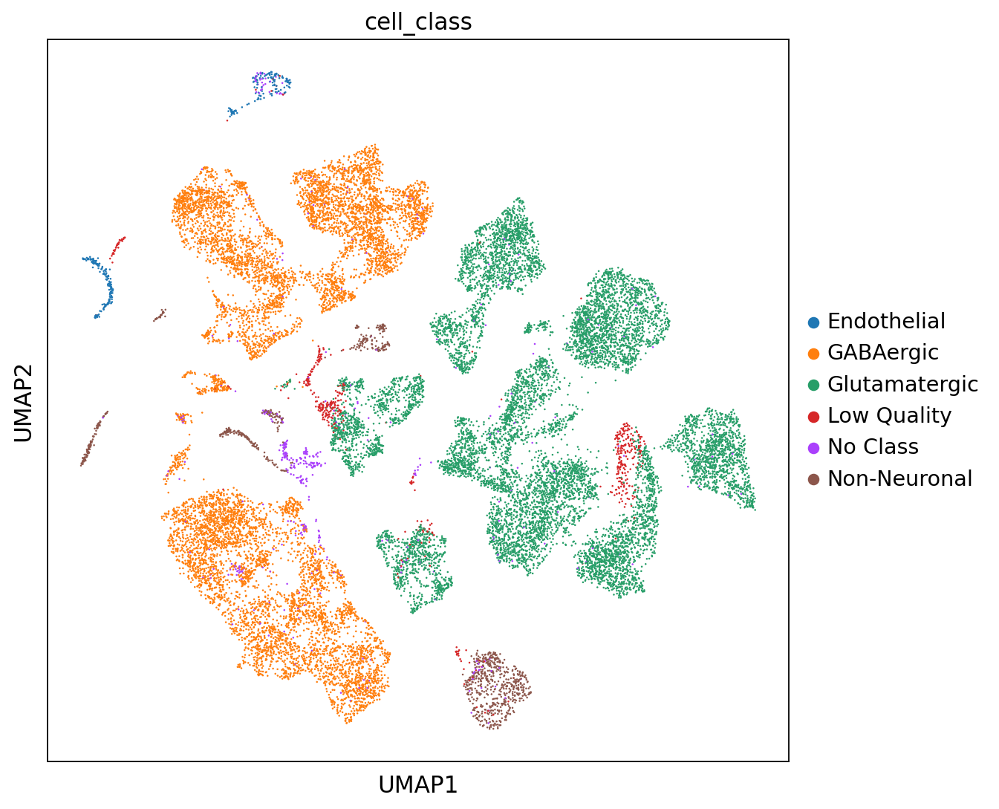

In [157]:
sc.pl.umap(new_adata, color=['cell_class'])

In [210]:
# cell_subclass中莫名存在一些浮点数，我们来将其转换为字符串：
new_adata.obs['cell_subclass'] = new_adata.obs['cell_subclass'].astype(str)


## 3.2 空间转录组与scRNA-Seq整合
### 3.2.1 取出皮质用于整合

In [138]:
# 空转数据取子集，取出对应区域的数据
# 实质上是取出皮质用于整合
adata_anterior_subset = adata_spatial_anterior[
    adata_spatial_anterior.obsm["spatial"][:, 1] < 6000, :
]
adata_posterior_subset = adata_spatial_posterior[
    (adata_spatial_posterior.obsm["spatial"][:, 1] < 4000)
    & (adata_spatial_posterior.obsm["spatial"][:, 0] < 6000),
    :,
]

### 3.2.2 合并、计算相关性、整合

In [ ]:
# 将两个空转数据先简单与scRNA-Seq数据合并
adatas_anterior = [new_adata, adata_anterior_subset]
adatas_posterior = [new_adata, adata_posterior_subset]


# 计算数据间的相关性
adatas_cor_anterior = scanorama.correct_scanpy(adatas_anterior, return_dimred=True)
adatas_cor_posterior = scanorama.correct_scanpy(adatas_posterior, return_dimred=True)

In [212]:
# 整合对象
adata_cortex_anterior = sc.concat(
    adatas_cor_anterior,
    label="dataset",
    keys=["smart-seq", "visium"],
    join="outer",
    uns_merge="first",
)
adata_cortex_posterior = sc.concat(
    adatas_cor_posterior,
    label="dataset",
    keys=["smart-seq", "visium"],
    join="outer",
    uns_merge="first",
)

In [186]:
adata_anterior_subset.obs_keys

<bound method AnnData.obs_keys of View of AnnData object with n_obs × n_vars = 966 × 32285
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'log1p', 'hvg'
    obsm: 'spatial'>

### 3.2.3 Label Transfer

In [ ]:
# 利用TransferData完整label的transfer

from sklearn.metrics.pairwise import cosine_distances

# 计算数据之间的余弦距离
distances_anterior = 1 - cosine_distances(
    adata_cortex_anterior[adata_cortex_anterior.obs.dataset == "smart-seq"].obsm[
        "X_scanorama"
    ],
    adata_cortex_anterior[adata_cortex_anterior.obs.dataset == "visium"].obsm[
        "X_scanorama"
    ],
)
distances_posterior = 1 - cosine_distances(
    adata_cortex_posterior[adata_cortex_posterior.obs.dataset == "smart-seq"].obsm[
        "X_scanorama"
    ],
    adata_cortex_posterior[adata_cortex_posterior.obs.dataset == "visium"].obsm[
        "X_scanorama"
    ],
)

distances_anterior

In [214]:
# 定义一个函数，利用上述的计算结果，根据数据相似度将已注释信息与未注释信息进行匹配
def label_transfer(dist, labels):
    lab = pd.get_dummies(labels).to_numpy().T
    class_prob = lab @ dist
    norm = np.linalg.norm(class_prob, 2, axis=0)
    class_prob = class_prob / norm
    class_prob = (class_prob.T - class_prob.min(1)) / class_prob.ptp(1)
    return class_prob

# 运行自定义函数
class_prob_anterior = label_transfer(
    distances_anterior, new_adata.obs.cell_subclass)
class_prob_posterior = label_transfer(
    distances_posterior, new_adata.obs.cell_subclass
)


In [ ]:
class_prob_anterior

In [215]:
# 将spot对应细胞类型的可能性整理为列表
cp_anterior_df = pd.DataFrame(
    class_prob_anterior, 
    columns=np.sort(new_adata.obs.cell_subclass.unique())
)
cp_posterior_df = pd.DataFrame(
    class_prob_posterior, 
    columns=np.sort(new_adata.obs.cell_subclass.unique())
)

# 看一下结果列表，每行为一个spot，每列是其与每种cell_subclass的"相似度"：
cp_posterior_df.iloc[0:5,0:5]

In [217]:
# 给数据框添加索引
cp_anterior_df.index = adata_anterior_subset.obs.index
cp_posterior_df.index = adata_posterior_subset.obs.index

# 将新获得的可能性列表添加至空转对象的obs注释中：
adata_anterior_subset_transfer = adata_anterior_subset.copy()
adata_anterior_subset_transfer.obs = pd.concat(
    [adata_anterior_subset.obs, cp_anterior_df], axis=1
)

adata_posterior_subset_transfer = adata_posterior_subset.copy()
adata_posterior_subset_transfer.obs = pd.concat(
    [adata_posterior_subset.obs, cp_posterior_df], axis=1
)

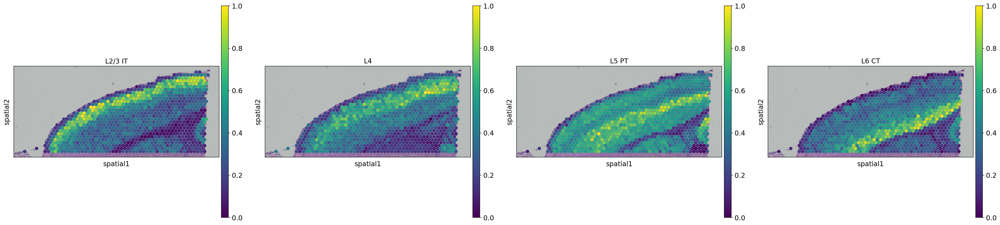

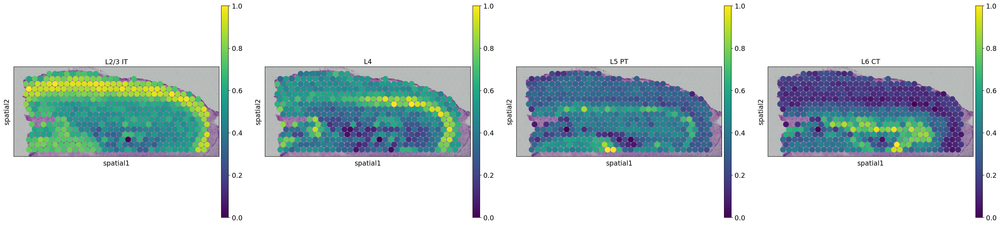

In [222]:
# 先看一下各细胞的"score"在空间上的分布情况
sc.pl.spatial(
    adata_anterior_subset_transfer,
    img_key="hires",
    color=["L2/3 IT", "L4", "L5 PT", "L6 CT"],
    size=1.5,
)
sc.pl.spatial(
    adata_posterior_subset_transfer,
    img_key="hires",
    color=["L2/3 IT", "L4", "L5 PT", "L6 CT"],
    size=1.5,
)

# 可以看出各个细胞的高分值区域分离程度较为明显，注释结果初步符合预期

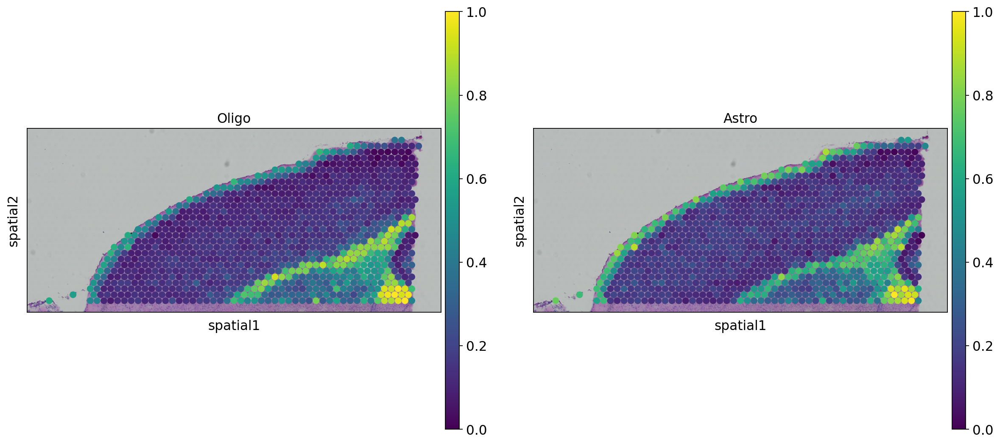

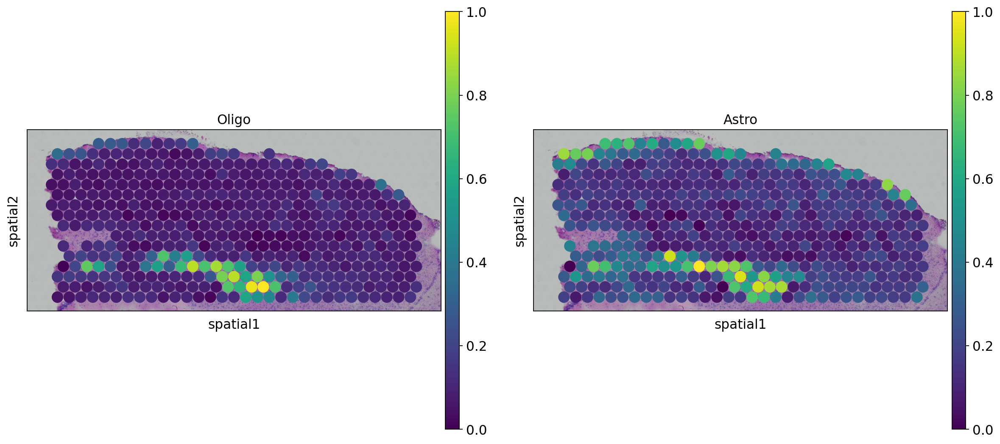

In [223]:
# 例如大家比较熟悉的astrocytes与oligodendrocytes： 

sc.pl.spatial(
    adata_anterior_subset_transfer, img_key="hires", color=["Oligo", "Astro"], size=1.5
)
sc.pl.spatial(
    adata_posterior_subset_transfer, img_key="hires", color=["Oligo", "Astro"], size=1.5
)

# 当然，各位实战时也不能完全相信label transfer，还需要结合marker gene加以矫正与注释

至此，空间转录组的基础分析便结束了，后续有时间的话会介绍相关的可视化。